本文数据来自：

[零基础入门金融风控-贷款违约预测-天池大赛-阿里云天池](https://tianchi.aliyun.com/competition/entrance/531830/introduction)

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
import warnings

warnings.filterwarnings("ignore")

## 总体了解

这一部分主要了解数据集整体情况，包括但不限于：

- 数据集规模
- 特征数
- 有哪些特征
- 不同特征数据类型
- 不同特征样本数
- 不同特征均值、标准差、中位等

In [2]:
data_train = pd.read_csv("data/train.csv")
data_test = pd.read_csv("data/testA.csv")

In [3]:
data_train.shape, data_test.shape

((800000, 47), (200000, 48))

In [4]:
data_train.columns

Index(['id', 'loanAmnt', 'term', 'interestRate', 'installment', 'grade',
       'subGrade', 'employmentTitle', 'employmentLength', 'homeOwnership',
       'annualIncome', 'verificationStatus', 'issueDate', 'isDefault',
       'purpose', 'postCode', 'regionCode', 'dti', 'delinquency_2years',
       'ficoRangeLow', 'ficoRangeHigh', 'openAcc', 'pubRec',
       'pubRecBankruptcies', 'revolBal', 'revolUtil', 'totalAcc',
       'initialListStatus', 'applicationType', 'earliesCreditLine', 'title',
       'policyCode', 'n0', 'n1', 'n2', 'n2.1', 'n4', 'n5', 'n6', 'n7', 'n8',
       'n9', 'n10', 'n11', 'n12', 'n13', 'n14'],
      dtype='object')

In [5]:
data_test.columns

Index(['id', 'loanAmnt', 'term', 'interestRate', 'installment', 'grade',
       'subGrade', 'employmentTitle', 'employmentLength', 'homeOwnership',
       'annualIncome', 'verificationStatus', 'issueDate', 'purpose',
       'postCode', 'regionCode', 'dti', 'delinquency_2years', 'ficoRangeLow',
       'ficoRangeHigh', 'openAcc', 'pubRec', 'pubRecBankruptcies', 'revolBal',
       'revolUtil', 'totalAcc', 'initialListStatus', 'applicationType',
       'earliesCreditLine', 'title', 'policyCode', 'n0', 'n1', 'n2', 'n2.1',
       'n2.2', 'n2.3', 'n4', 'n5', 'n6', 'n7', 'n8', 'n9', 'n10', 'n11', 'n12',
       'n13', 'n14'],
      dtype='object')

In [6]:
set(data_test.columns) - set(data_train.columns) 

{'n2.2', 'n2.3'}

In [7]:
set(data_train.columns) - set(data_test.columns) 

{'isDefault'}

In [8]:
data_train.dtypes

id                      int64
loanAmnt              float64
term                    int64
interestRate          float64
installment           float64
grade                  object
subGrade               object
employmentTitle       float64
employmentLength       object
homeOwnership           int64
annualIncome          float64
verificationStatus      int64
issueDate              object
isDefault               int64
purpose                 int64
postCode              float64
regionCode              int64
dti                   float64
delinquency_2years    float64
ficoRangeLow          float64
ficoRangeHigh         float64
openAcc               float64
pubRec                float64
pubRecBankruptcies    float64
revolBal              float64
revolUtil             float64
totalAcc              float64
initialListStatus       int64
applicationType         int64
earliesCreditLine      object
title                 float64
policyCode            float64
n0                    float64
n1        

In [9]:
data_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 800000 entries, 0 to 799999
Data columns (total 47 columns):
id                    800000 non-null int64
loanAmnt              800000 non-null float64
term                  800000 non-null int64
interestRate          800000 non-null float64
installment           800000 non-null float64
grade                 800000 non-null object
subGrade              800000 non-null object
employmentTitle       799999 non-null float64
employmentLength      753201 non-null object
homeOwnership         800000 non-null int64
annualIncome          800000 non-null float64
verificationStatus    800000 non-null int64
issueDate             800000 non-null object
isDefault             800000 non-null int64
purpose               800000 non-null int64
postCode              799999 non-null float64
regionCode            800000 non-null int64
dti                   799761 non-null float64
delinquency_2years    800000 non-null float64
ficoRangeLow          800000 non-

In [10]:
data_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 48 columns):
id                    200000 non-null int64
loanAmnt              200000 non-null float64
term                  200000 non-null int64
interestRate          200000 non-null float64
installment           200000 non-null float64
grade                 200000 non-null object
subGrade              200000 non-null object
employmentTitle       200000 non-null float64
employmentLength      188258 non-null object
homeOwnership         200000 non-null int64
annualIncome          200000 non-null float64
verificationStatus    200000 non-null int64
issueDate             200000 non-null object
purpose               200000 non-null int64
postCode              200000 non-null float64
regionCode            200000 non-null int64
dti                   199939 non-null float64
delinquency_2years    200000 non-null float64
ficoRangeLow          200000 non-null float64
ficoRangeHigh         200000 no

In [11]:
data_train.describe().T

,count,mean,std,min,25%,50%,75%,max
id,800000.0,399999.500000,230940.252013,0.00,199999.75,399999.500,599999.25,799999.00
loanAmnt,800000.0,14416.818875,8716.086178,500.00,8000.00,12000.000,20000.00,40000.00
term,800000.0,3.482745,0.855832,3.00,3.00,3.000,3.00,5.00
interestRate,800000.0,13.238391,4.765757,5.31,9.75,12.740,15.99,30.99
installment,800000.0,437.947723,261.460393,15.69,248.45,375.135,580.71,1715.42
employmentTitle,799999.0,72005.351714,106585.640204,0.00,427.00,7755.000,117663.50,378351.00
homeOwnership,800000.0,0.614213,0.675749,0.00,0.00,1.000,1.00,5.00
annualIncome,800000.0,76133.910493,68947.513672,0.00,45600.00,65000.000,90000.00,10999200.00
verificationStatus,800000.0,1.009683,0.782716,0.00,0.00,1.000,2.00,2.00
isDefault,800000.0,0.199513,0.399634,0.00,0.00,0.000,0.00,1.00


In [12]:
data_train.head().append(data_train.tail()).T

,0,1,2,3,4,799995,799996,799997,799998,799999
id,0,1,2,3,4,799995,799996,799997,799998,799999
loanAmnt,35000,18000,12000,11000,3000,25000,17000,6000,19200,9000
term,5,5,5,3,3,3,3,3,3,3
interestRate,19.52,18.49,16.99,7.26,12.99,14.49,7.9,13.33,6.92,11.06
installment,917.97,461.9,298.17,340.96,101.07,860.41,531.94,203.12,592.14,294.91
grade,E,D,D,A,C,C,A,C,A,B
subGrade,E2,D2,D3,A4,C2,C4,A4,C3,A4,B3
employmentTitle,320,219843,31698,46854,54,2659,29205,2582,151,13
employmentLength,2 years,5 years,8 years,10+ years,NaN,7 years,10+ years,10+ years,10+ years,5 years
homeOwnership,2,0,0,1,1,1,0,1,0,0


## 缺失值和唯一值

主要探索：

- 如何处理特征的缺失值？
- 如何处理唯一值的特征？

### 缺失值

In [13]:
# 判断有多少个缺失特征
n_missing = data_train.isna().any().sum()
# 类似：data_train.isnull().any().sum()
n_missing

22

In [14]:
def feature_null_more_than_ratio(data: pd.DataFrame, ratio: float) -> dict:
    have_null_fea_dict = (data.isnull().sum()/len(data)).to_dict()
    res = {}
    for key,val in have_null_fea_dict.items():
        if val > ratio:
            res[key] = val
    return res

In [15]:
# 缺失值超过一定比例的特征
for ratio in np.linspace(0.1, 1, 10):
    dct = feature_null_more_than_ratio(data_train, ratio)
    print("features null ratio bigger than {}: {}".format(ratio, dct))

features null ratio bigger than 0.1: {}
features null ratio bigger than 0.2: {}
features null ratio bigger than 0.30000000000000004: {}
features null ratio bigger than 0.4: {}
features null ratio bigger than 0.5: {}
features null ratio bigger than 0.6: {}
features null ratio bigger than 0.7000000000000001: {}
features null ratio bigger than 0.8: {}
features null ratio bigger than 0.9: {}
features null ratio bigger than 1.0: {}


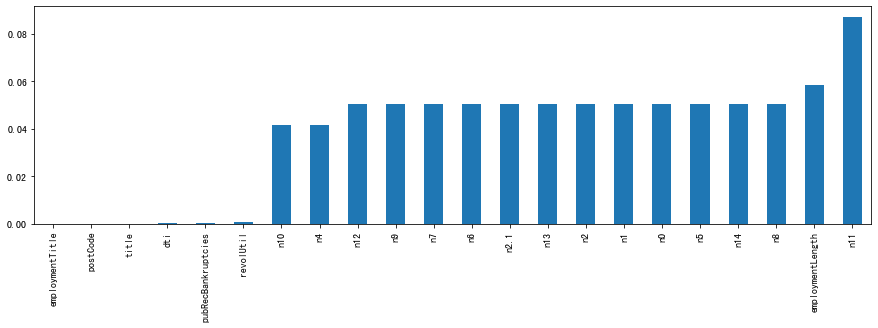

In [16]:
# 不同特征缺失值比例
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 4))

missing = data_train.isnull().sum()/len(data_train)
missing = missing[missing > 0]
missing.sort_values(inplace=True)
missing.plot.bar(ax = ax);

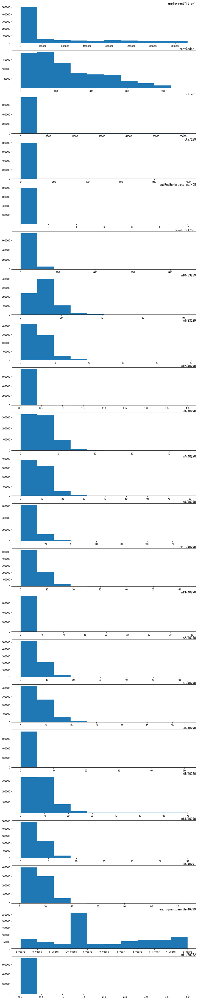

In [278]:
# 有缺失值的特征数据分布
fig, axes = plt.subplots(nrows=n_missing, ncols=1, figsize=(12, 3*n_missing))
for i, (key, val) in enumerate(missing.to_dict().items()):
    val = int(val * len(data_train))
    axes[i].hist(data_train[key].dropna());
    axes[i].set_title(key +"/" + str(val), loc='right', pad=1.0);

对于缺失值的处理：

- employmentTitle，postCode，title：众数
- employmentLength：转换后平均或分桶后取样本数最多的桶
- dti，revolUtil：：加权平均
- pubRecBankruptcies，n14，n13，n12，n11，n10，n9，n8，n7，n6，n5，n4，n2，n1，n0：加权平均后取整

In [96]:
fea = "employmentLength"
data_train[fea].dropna().value_counts()

10+ years    262753
2 years       72358
< 1 year      64237
3 years       64152
1 year        52489
5 years       50102
4 years       47985
6 years       37254
8 years       36192
7 years       35407
9 years       30272
Name: employmentLength, dtype: int64

### 唯一值

对唯一值直接去掉：

- policyCode

In [97]:
[col for col in data_train.columns if data_train[col].nunique() <= 1]

['policyCode']

In [100]:
[col for col in data_test.columns if data_test[col].nunique() <= 1]

['policyCode']

## 数据类型

数据特征类型一般包括以下几类：

- 数值数据：定量数据
  - 离散数据
  - 连续数据
- 分类数据：定性数据

度量数据有以下不同方法：

- 标签
- 序数
- 区间
- 比率


数值数据一般可以直接用于模型，但风控时往往要对其进行分桶，对其 WOE 编码后再使用，[这里](https://yam.gift/2020/09/15/ML/2020-09-15-Metrics/)提到过，这其实是一种非线性的思路，能够降低模型复杂度，减少噪声影响，使得模型更加稳定。

主要探索：

- 数据分布如何？
- 如何转换数据？

In [558]:
# unique
for fea in data_train.columns:
    print("Feature:", fea, "\t",
          "Number Unique:", len(data_train[fea].unique()), "\t",
          "Sample:", data_train[fea].iloc[0])

Feature: id 	 Number Unique: 800000 	 Sample: 0
Feature: loanAmnt 	 Number Unique: 1540 	 Sample: 35000.0
Feature: term 	 Number Unique: 2 	 Sample: 5
Feature: interestRate 	 Number Unique: 641 	 Sample: 19.52
Feature: installment 	 Number Unique: 72360 	 Sample: 917.97
Feature: grade 	 Number Unique: 7 	 Sample: E
Feature: subGrade 	 Number Unique: 35 	 Sample: E2
Feature: employmentTitle 	 Number Unique: 248684 	 Sample: 320.0
Feature: employmentLength 	 Number Unique: 12 	 Sample: 2 years
Feature: homeOwnership 	 Number Unique: 6 	 Sample: 2
Feature: annualIncome 	 Number Unique: 44926 	 Sample: 110000.0
Feature: verificationStatus 	 Number Unique: 3 	 Sample: 2
Feature: issueDate 	 Number Unique: 139 	 Sample: 2014-07-01
Feature: isDefault 	 Number Unique: 2 	 Sample: 1
Feature: purpose 	 Number Unique: 14 	 Sample: 1
Feature: postCode 	 Number Unique: 933 	 Sample: 137.0
Feature: regionCode 	 Number Unique: 51 	 Sample: 32
Feature: dti 	 Number Unique: 6322 	 Sample: 17.05
Feature

In [281]:
# 不同数据类型
numerical_fea = list(data_train.select_dtypes(exclude=['object']).columns)
print("Numerical Features: ", len(numerical_fea))
category_fea = list(filter(lambda x: x not in numerical_fea,list(data_train.columns)))
print("Category Features: ", len(category_fea))
for fea in category_fea:
    print("Feature: ", fea, "\t",
          "Number Unique:", len(data_train[fea].unique()), "\t",
          "Sample: ", data_train[fea].iloc[0])

Numerical Features:  42
Category Features:  5
Feature:  grade 	 Number Unique: 7 	 Sample:  E
Feature:  subGrade 	 Number Unique: 35 	 Sample:  E2
Feature:  employmentLength 	 Number Unique: 12 	 Sample:  2 years
Feature:  issueDate 	 Number Unique: 139 	 Sample:  2014-07-01
Feature:  earliesCreditLine 	 Number Unique: 720 	 Sample:  Aug-2001


In [763]:
def is_float(x):
    return bool(int(x) - x)

def all_unique_is_float(arr):
    for i in arr:
        if is_float(i):
            return True
    return False

In [775]:
# 离散/连续数据类型
# numerical_serial_fea = [fea for fea in numerical_fea if data_train[fea].nunique() > 10]
numerical_serial_fea = [fea for fea in numerical_fea if 
                        all_unique_is_float(data_train[fea].dropna().unique())
                       or data_train[fea].nunique() > 50]
numerical_discrate_fea = [fea for fea in numerical_fea if fea not in numerical_serial_fea]

In [776]:
numerical_discrate_fea

['term',
 'homeOwnership',
 'verificationStatus',
 'isDefault',
 'purpose',
 'delinquency_2years',
 'ficoRangeLow',
 'ficoRangeHigh',
 'pubRec',
 'pubRecBankruptcies',
 'initialListStatus',
 'applicationType',
 'policyCode',
 'n0',
 'n1',
 'n2',
 'n2.1',
 'n4',
 'n9',
 'n11',
 'n12',
 'n13',
 'n14']

In [777]:
numerical_serial_fea

['id',
 'loanAmnt',
 'interestRate',
 'installment',
 'employmentTitle',
 'annualIncome',
 'postCode',
 'regionCode',
 'dti',
 'openAcc',
 'revolBal',
 'revolUtil',
 'totalAcc',
 'title',
 'n5',
 'n6',
 'n7',
 'n8',
 'n10']

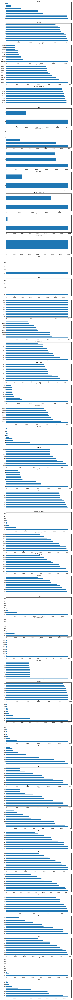

In [656]:
# value counts
vc_features = features #category_fea + numerical_discrate_fea
rows = len(vc_features)
fig, axes = plt.subplots(nrows=rows, ncols=1, figsize=(12, 4*rows))
for i, fea in enumerate(vc_features):
#     sns.barplot(
#         x=list(data_train[fea].value_counts())[:10], 
#         y=data_train[fea].value_counts().keys()[:10],
#         ax = axes[i]
#     )
    data_train[fea].value_counts().nlargest(10).plot(
        kind='barh', ax=axes[i])
    axes[i].set_title(fea)

In [371]:
# 看分布（离散/连续数据类型）进一步验证
features = category_fea + numerical_discrate_fea + numerical_serial_fea
df = data_train[features]

In [559]:
figsize = (18, 40)
cols = 4
rows = len(features) // cols + 1

def trim_axs(axs, N):
    axs = axs.flat
    for ax in axs[N:]:
        ax.remove()
    return axs[:N]

In [569]:
def plot_hist(fea_data, ax):
    if fea_data.dtype == "object":
        ax.hist(fea_data, bins=15)
    else:
        try:
            sns.distplot(fea_data, ax=ax, axlabel=False)
        except Exception as e:
            ax.hist(fea_data, bins=15)

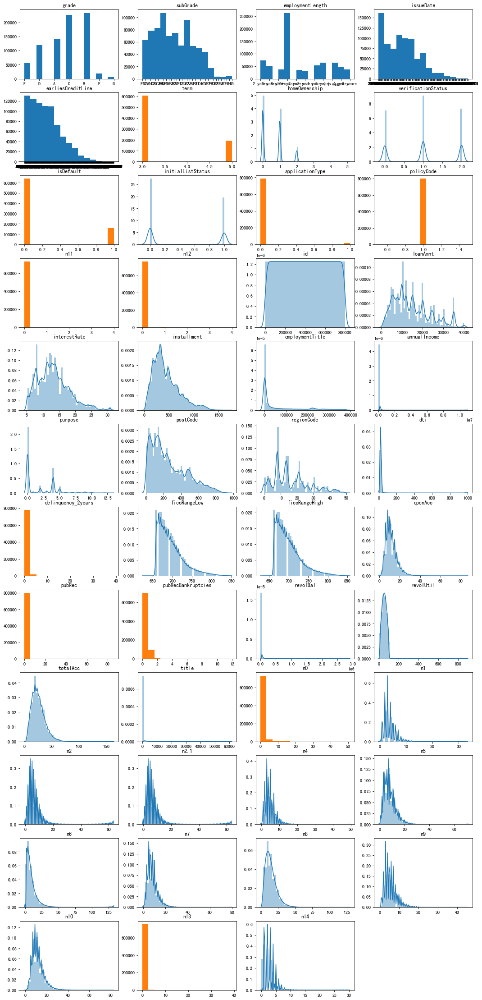

In [570]:
axs = plt.figure(figsize=figsize, constrained_layout=False).subplots(rows, cols)
axs = trim_axs(axs, len(features))

for ax, fea in zip(axs, features):
    fea_data = df[fea].dropna()
    ax.set_title(fea)
    plot_hist(fea_data, ax)

类别数据：

- grade 贷款等级
- subGrade 贷款等级之子级
- employmentLength 就业年限（年）
- issueDate 贷款发放的月份
- earliesCreditLine 借款人最早报告的信用额度开立的月份


数值数据：

- id
- loanAmnt 贷款金额
- interestRate 贷款利率
- installment 分期付款金额
- employmentTitle 就业职称
- annualIncome 年收入
- postCode 借款人在贷款申请时的贷款用途类别
- regionCode 地区编码
- purpose 借款人在贷款申请时的贷款用途类别
- dti 债务收入比
- delinquency_2years 借款人过去2年信用档案中逾期30天以上的违约事件数
- ficoRangeLow 借款人在贷款发放时的fico所属的下限范围
- ficoRangeHigh 借款人在贷款发放时的fico所属的上限范围
- openAcc 借款人信用档案中未结信用额度的数量
- pubRec 贬损公共记录的数量
- pubRecBankruptcies 公开记录清除的数量
- revolBal 信贷周转余额合计
- revolUtil 循环额度利用率，或借款人使用的相对于所有可用循环信贷的信贷金额
- totalAcc 借款人信用档案中当前的信用额度总数
- title 借款人提供的贷款名称
- n 系列：n0 n1 n2 n2.1 n4 n5 n6 n7 n8 n9 n10 n13 n14


- term 贷款期限
- homeOwnership 借款人在登记时提供的房屋所有权状况
- verificationStatus 验证状态
- initialListStatus 贷款的初始列表状态
- applicationType 表明贷款是个人申请还是与两个共同借款人的联合申请
- n 系列：n11 n12

In [435]:
set(data_test["purpose"].dropna().to_list())

{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13}

In [466]:
# 偏态
skews = data_train[numerical_serial_fea].skew()
skews

id                    1.586291e-17
loanAmnt              7.826221e-01
interestRate          7.123646e-01
installment           1.006328e+00
employmentTitle       1.379124e+00
annualIncome          4.618773e+01
purpose               1.251126e+00
postCode              8.321358e-01
regionCode            7.824390e-01
dti                   2.730132e+01
delinquency_2years    5.685041e+00
ficoRangeLow          1.282404e+00
ficoRangeHigh         1.282608e+00
openAcc               1.298413e+00
pubRec                1.352173e+01
pubRecBankruptcies    3.440526e+00
revolBal              1.592468e+01
revolUtil            -1.805942e-02
totalAcc              9.560535e-01
title                 5.225696e+00
n0                    5.106909e+00
n1                    1.400085e+00
n2                    1.542892e+00
n2.1                  1.542892e+00
n4                    1.701304e+00
n5                    1.339371e+00
n6                    2.063377e+00
n7                    1.471781e+00
n8                  

In [526]:
def addone(x):
    return x + 1e-5

In [539]:
new_data

0         2.836151
1         3.326115
2         3.125444
3         2.845491
4         3.470724
            ...   
799995    2.946017
799996    2.754934
799997    2.494032
799998    3.375880
799999    2.196114
Name: dti, Length: 799759, dtype: float64

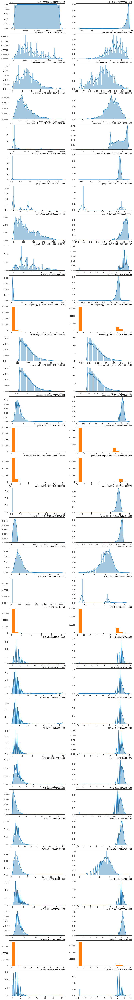

In [546]:
# 非正态的尝试 log 化
# sns.FacetGrid(df, size=2).map(sns.distplot, fea, ax=ax).add_legend()
skew_dict = skews.to_dict()
fig, axes = plt.subplots(nrows=len(skew_dict), ncols=2, figsize=(12, 3*len(skew_dict)))

for i, (key, val) in enumerate(skew_dict.items()):
    fea_data = df[key].dropna()
    plot_hist(fea_data, ax=axes[i, 0])
    axes[i, 0].set_title(key +"/" + str(val), loc='right', pad=1.0)
    
    new_data = fea_data.dropna().apply(addone).apply(np.log).dropna()
    plot_hist(new_data, ax=axes[i, 1])
    new_val = new_data.skew()
    axes[i, 1].set_title(key +"/" + str(new_val), loc='right', pad=1.0)

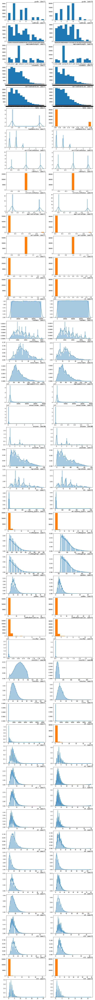

In [573]:
# 不同特征值在不同 label 上的分布
fig, axes = plt.subplots(nrows=len(features), ncols=2, figsize=(12, 3*len(features)))

for i, fea in enumerate(features):
    fea_data = data_train[data_train.isDefault == 1][fea].dropna()
    plot_hist(fea_data, ax=axes[i, 0])
    axes[i, 0].set_title(fea + "  Label=1", loc='right', pad=1.0)
    
    fea_data = data_train[data_train.isDefault == 0][fea].dropna()
    plot_hist(fea_data, ax=axes[i, 1])
    axes[i, 1].set_title(fea + "  Label=0", loc='right', pad=1.0)

In [400]:
# category 编码
import category_encoders as ce

fea = "grade"

encoder1 = ce.OneHotEncoder(cols=[fea])
encoder2 = ce.OrdinalEncoder(cols=[fea])
encoder3 = ce.TargetEncoder(cols=[fea])
encoder4 = ce.CatBoostEncoder(cols=[fea])

tmp = data_train

X = tmp[fea]
y = tmp.isDefault

encoder3.fit(X, y)
encoder3.transform(X)

## 数据间关系

主要探索：

- 特征之间的关系？
- 数据和因变量之间的关系？

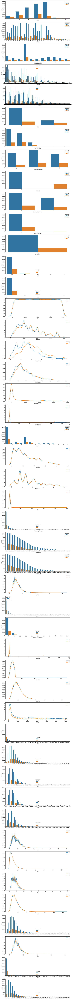

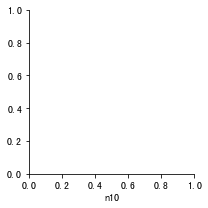

In [780]:
rows = len(features)
need_drop_feas = ["policyCode", "isDefault"]
fig, axes = plt.subplots(nrows=rows, ncols=1, figsize=(12, 4*rows))
g = sns.FacetGrid(data_train, hue="isDefault")
for i, fea in enumerate(features):
    ax.set_title(fea)
    if fea in category_fea + numerical_discrate_fea:
        sns.countplot(fea, hue="isDefault", data=data_train, ax=axes[i])
    else:
        g = g.map(sns.distplot, fea, hist=False, rug=False, ax=axes[i])

In [793]:
df = data_train.drop(columns=['policyCode'])
df = df.dropna()

In [794]:
grade_dct = dict(zip(['A', 'B', 'C', 'D', 'E', 'F', 'G'], range(10, 80, 10)))
def deal_grade(x):
    return grade_dct.get(x)
df["grade"] = df["grade"].apply(deal_grade)

In [795]:
def deal_sub_grade(x):
    return grade_dct.get(x[0]) + int(x[1])
df["subGrade"] = df["subGrade"].apply(deal_sub_grade)

In [796]:
def deal_employmentLength(x):
    if x == "10+ years":
        return 10.0
    elif x == "< 1 year":
        return 0.5
    else:
        return float(x[0])
df["employmentLength"] = df["employmentLength"].apply(deal_employmentLength)

In [798]:
def deal_date(x):
    return int(x.split("-")[1])
df["issueDate"] = df["issueDate"].apply(deal_date)
df["earliesCreditLine"] = df["earliesCreditLine"].apply(deal_date)

In [801]:
df.shape

(686195, 46)

In [841]:
sns.pairplot(df)

In [802]:
correlation = df.corr(method='pearson')
correlation

,id,loanAmnt,term,interestRate,installment,grade,subGrade,employmentTitle,employmentLength,homeOwnership,...,n5,n6,n7,n8,n9,n10,n11,n12,n13,n14
id,1.000000,-0.000137,-0.000473,0.000891,0.000064,0.000726,0.000829,-0.000321,0.000131,0.000480,...,0.001224,-0.000005,-0.000774,0.000325,-0.001075,-0.000716,-0.001491,0.001352,-0.000549,0.000910
loanAmnt,-0.000137,1.000000,0.379981,0.138414,0.952859,0.138764,0.141862,-0.013124,0.084307,-0.135043,...,0.199807,0.068186,0.161663,0.172961,0.144367,0.169741,-0.000195,0.001058,-0.019254,-0.022880
term,-0.000473,0.379981,1.000000,0.424135,0.139269,0.432181,0.439224,-0.002889,0.053551,-0.081535,...,0.050838,0.068340,0.049326,0.057561,0.051015,0.067234,0.000078,-0.000664,-0.009914,0.025177
interestRate,0.000891,0.138414,0.424135,1.000000,0.149650,0.955392,0.973036,0.088540,-0.007121,0.054506,...,-0.078071,0.009437,-0.002851,-0.050779,0.093593,-0.006641,0.004572,0.015520,0.026478,0.207397
installment,0.000064,0.952859,0.139269,0.149650,1.000000,0.140537,0.143903,-0.003201,0.072138,-0.109258,...,0.186735,0.052563,0.157911,0.160584,0.151995,0.159538,0.000639,0.003581,-0.013776,-0.002539
grade,0.000726,0.138764,0.432181,0.955392,0.140537,1.000000,0.993899,0.025339,-0.007262,0.055954,...,-0.081755,0.014100,-0.000357,-0.048262,0.094926,-0.001089,0.005209,0.018756,0.027621,0.213758
subGrade,0.000829,0.141862,0.439224,0.973036,0.143903,0.993899,1.000000,0.025738,-0.007805,0.057834,...,-0.084117,0.013915,-0.000640,-0.049757,0.097255,-0.001628,0.005506,0.019117,0.028449,0.218171
employmentTitle,-0.000321,-0.013124,-0.002889,0.088540,-0.003201,0.025339,0.025738,1.000000,0.004445,-0.012711,...,0.035327,-0.040999,-0.010159,0.003841,0.009572,-0.034370,-0.002532,-0.008490,-0.010400,-0.041281
employmentLength,0.000131,0.084307,0.053551,-0.007121,0.072138,-0.007262,-0.007805,0.004445,1.000000,-0.126093,...,0.112959,-0.050802,0.111677,0.145870,0.124596,0.035308,0.003859,0.007286,-0.004126,0.022276
homeOwnership,0.000480,-0.135043,-0.081535,0.054506,-0.109258,0.055954,0.057834,-0.012711,-0.126093,1.000000,...,-0.057957,-0.059186,-0.036628,-0.072769,-0.042051,-0.086234,-0.000435,-0.010579,0.003331,-0.029507


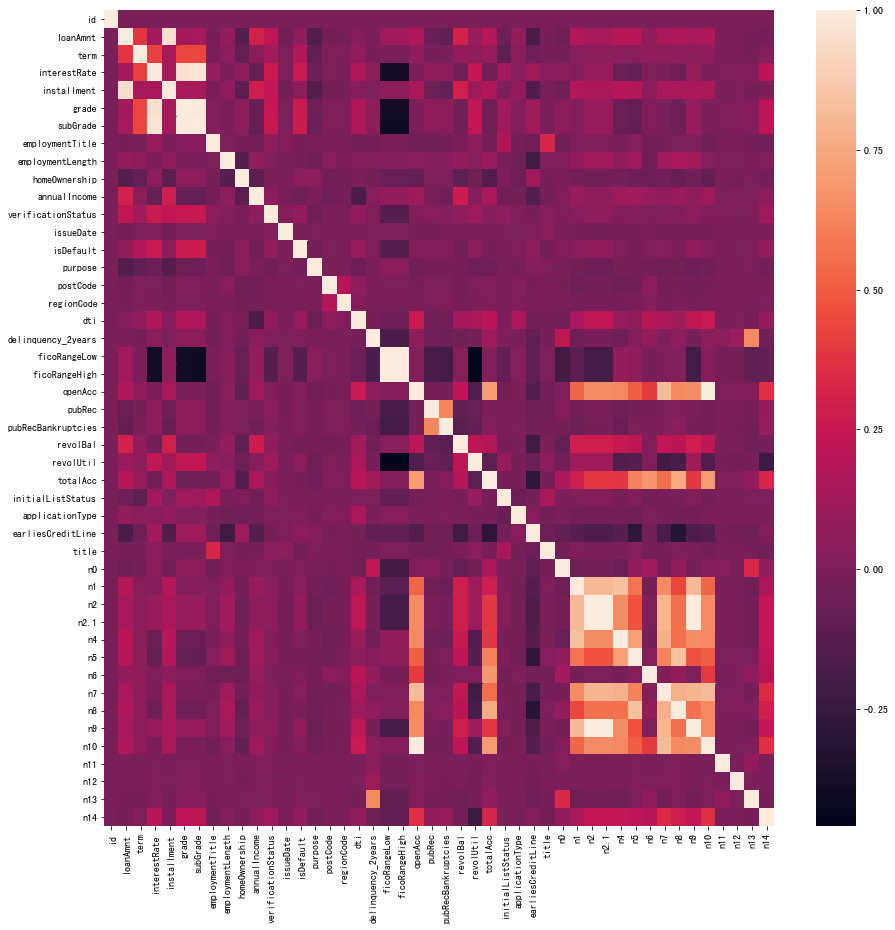

In [834]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 15))

sns.heatmap(correlation,
           ax=ax,
           fmt='.1f',
           xticklabels=correlation.columns,
           yticklabels=correlation.columns)

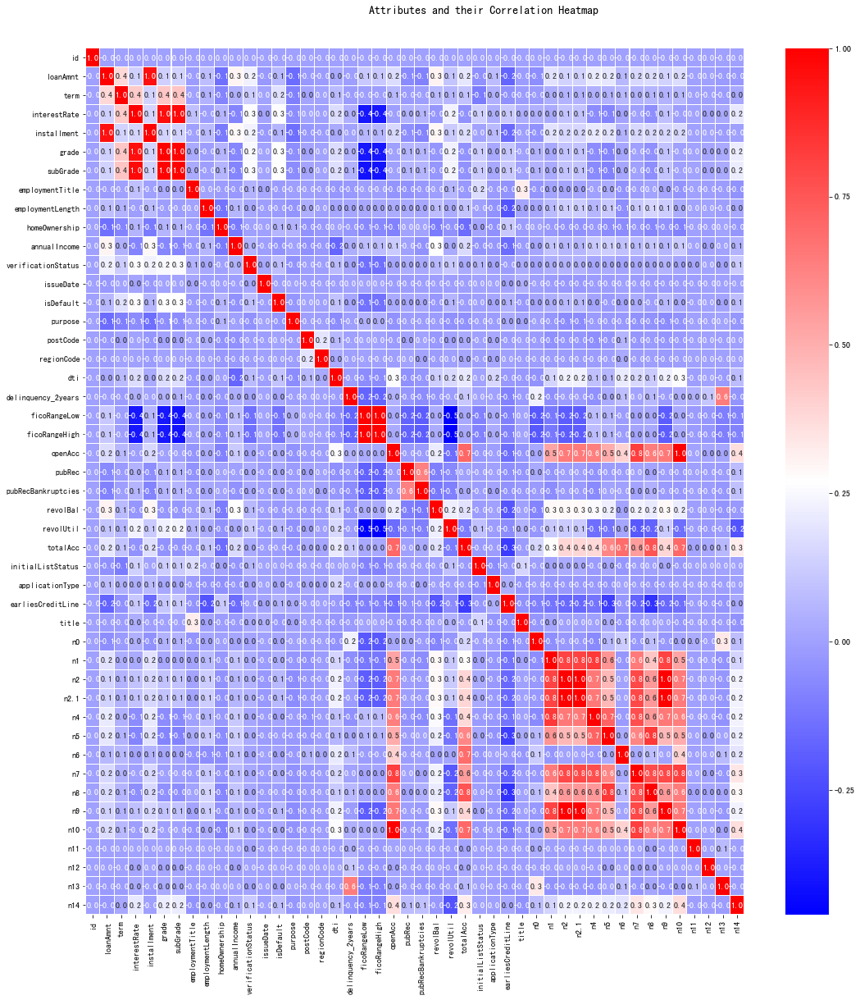

In [840]:
fig, (ax) = plt.subplots(1, 1, figsize=(18, 18))

hm = sns.heatmap(correlation, 
                 ax=ax,           
                 cmap="bwr", 
                 annot=True, 
                 fmt='.1f',       
                 linewidths=.05)

fig.subplots_adjust(top=0.94)
fig.suptitle('Attributes and their Correlation Heatmap', 
              fontsize=14, 
              fontweight='bold');